# Comparing different datasets, NK cells

Datasets:

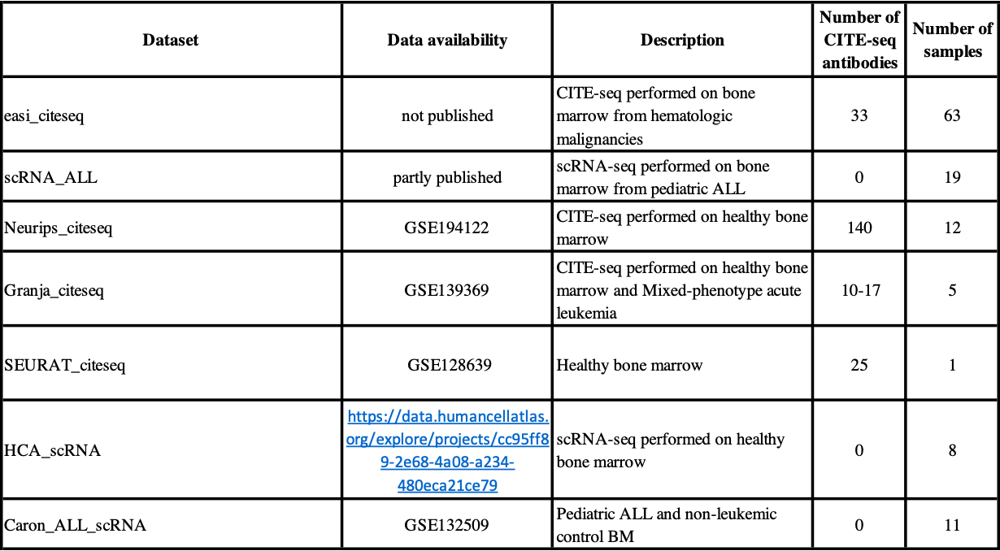

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap
from muon import prot as pt

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


## Neurips

In [2]:
#Neurips

adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm.h5ad')

In [3]:
neurips_prot=adata_neurips.obsm['protein_expression_clr_neurips']

In [4]:
neurips_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15,CD117,CD66ace
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CTCAAGAGTCACAGAG-1-s4d1,0.652674,1.069339,1.657770,0.890243,1.377072,1.264995,1.863027,1.101769,1.562259,1.072649,...,1.786480,0.762359,1.112478,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CGTGATAGTTATCTGG-1-s4d1,0.000000,1.249182,1.335424,1.256332,2.674106,1.322314,0.289336,1.240123,1.397398,1.525053,...,0.629556,0.854928,1.000442,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AGATCCAAGATCGGTG-1-s4d1,2.784459,1.132949,1.674846,1.669058,1.663981,2.101246,2.112640,1.417276,1.884321,1.861734,...,2.808629,2.007436,2.064066,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTGGTTAGTCGAGTTT-1-s1d3,0.000000,0.175083,0.734526,0.000000,0.505917,1.235054,1.241451,0.512721,0.502246,1.766372,...,0.519947,0.484666,0.497623,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GCTACAACAGTGCGCT-1-s1d3,0.378666,0.453643,0.894450,0.000000,0.766577,1.058199,1.529611,0.512721,0.663922,1.766372,...,1.415230,0.854928,0.560915,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AACAAAGGTTGGTACT-1-s1d3,0.378666,0.324031,1.094684,0.306698,0.401377,1.983838,2.156735,0.512721,0.835018,2.400949,...,1.315806,0.605141,0.357584,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TGACAGTCATGGCTGC-1-s1d3,0.378666,0.764571,0.776968,0.306698,0.152401,1.358780,1.753042,0.201533,0.586348,1.543085,...,1.113769,0.660339,0.960123,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
adata_neurips.obs['new_cell_type'].unique()

['NK', 'T', 'Prog', 'Myel', 'B', 'DC', 'E', 'Normoblast']
Categories (8, object): ['B', 'DC', 'E', 'Myel', 'NK', 'Normoblast', 'Prog', 'T']

In [6]:
#Select only T-cells

neurips_nk=adata_neurips[adata_neurips.obs['new_cell_type'] == 'NK' ]

In [7]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 8051
    obs: 'cell_type', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'eg_code', 'leiden_r1', 'new_cell_type', 'batch_group'
    uns: 'neighbors', 'new_cell_type_colors', 'umap'
    obsm: 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    obsp: 'connectivities', 'distances'

In [8]:
neurips_nk_prot=neurips_nk.obsm['protein_expression_clr_neurips']

In [9]:
neurips_nk_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15,CD117,CD66ace
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GCAACATTCGCAAGAG-1-s4d1,0.378666,1.192753,1.208881,0.000000,1.456877,1.046035,1.333993,0.638218,1.360894,1.072649,...,0.329073,1.280509,0.676616,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TCACGGGTCGCACGAC-1-s4d1,0.000000,0.849902,1.548700,0.730824,1.530781,1.883102,1.686271,1.240123,1.804089,0.812797,...,0.576253,1.189870,1.000442,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CGCCAGAAGACCATTC-1-s4d1,0.652674,1.249182,1.404314,0.306698,1.417770,1.664855,1.409627,1.302726,1.663363,0.849218,...,0.680162,1.415407,0.729806,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ATCATTCGTCCAATCA-1-s1d3,0.000000,0.568367,1.124479,1.027708,0.600556,2.007513,1.679342,0.749707,0.545181,0.288523,...,0.519947,0.809714,0.357584,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ACATTTCCAGCAGTGA-1-s1d3,0.000000,0.671273,0.856802,0.000000,0.284617,1.105431,0.818721,0.201533,0.309292,0.652195,...,0.519947,0.546717,0.194691,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TGAGACTTCCTTCAGC-1-s1d3,0.000000,0.671273,0.734526,0.306698,0.284617,1.255114,1.174628,0.749707,0.625887,0.406586,...,0.396827,0.418509,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GAGATGGTCCGCCTAT-1-s1d3,0.000000,0.928521,0.999570,0.541080,0.600556,1.759143,2.420602,1.024682,0.700563,0.406586,...,0.576253,0.546717,0.430053,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [10]:
#To exclude columns that contain only zeros

neurips_nk_prot = pd.DataFrame(neurips_nk_prot)
neurips_nk_prot != 0
(neurips_nk_prot != 0).any(axis=0)
neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]
neurips_nk_prot = neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]

for col in neurips_nk_prot:
    print(col)

CD86
CD274
CD270
CD155
CD112
CD47
CD48
CD40
CD154
CD52
CD3
CD8
CD56
CD19
CD33
CD11c
HLA-A-B-C
CD45RA
CD123
CD7
CD105
CD49f
CD194
CD4
CD44
CD14
CD16
CD25
CD45RO
CD279
TIGIT
CD20
CD335
CD31
Podoplanin
CD146
IgM
CD5
CD195
CD32
CD196
CD185
CD103
CD69
CD62L
CD161
CD152
CD223
KLRG1
CD27
CD107a
CD95
CD134
HLA-DR
CD1c
CD11b
CD64
CD141
CD1d
CD314
CD35
CD57
CD272
CD278
CD58
CD39
CX3CR1
CD24
CD21
CD11a
CD79b
CD244
CD169
integrinB7
CD268
CD42b
CD54
CD62P
CD119
TCR
CD192
CD122
FceRIa
CD41
CD137
CD163
CD83
CD124
CD13
CD2
CD226
CD29
CD303
CD49b
CD81
IgD
CD18
CD28
CD38
CD127
CD45
CD22
CD71
CD26
CD115
CD63
CD304
CD36
CD172a
CD72
CD158
CD93
CD49a
CD49d
CD73
CD9
TCRVa7.2
TCRVd2
LOX-1
CD158b
CD158e1
CD142
CD319
CD352
CD94
CD162
CD85j
CD23
CD328
HLA-E
CD82
CD101
CD88
CD224


## Granja

In [11]:
adata_granja = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_granja_norm.h5ad')


In [12]:
adata_granja.obs['cell_type'].unique().to_list()

['CD4+ T 1',
 'CD14+ monocyte 1',
 'Pre B',
 'Pro B',
 'CD8+ T',
 'Promonocyte',
 'CD14+ monocyte 2',
 'Plasmacytoid dendritic cell',
 'NK T 2',
 'Immature B',
 'Late erythoid precursor 1',
 'Pre B (cycling)',
 'NK',
 'Late erythoid precursor 3',
 'Early erythoid precursor',
 'CD16+ monocyte',
 'Conventional dendritic cell',
 'HSC',
 'NK T 1',
 'Late erythoid precursor 2',
 'Plasma B cell',
 'Stromal cell',
 'Megakaryocyte',
 nan]

In [13]:
#Select T-cells
granja_nk=adata_granja[adata_granja.obs['new_cell_type'] == 'NK' ]

In [14]:
granja_nk

View of AnnData object with n_obs × n_vars = 1033 × 8051
    obs: 'cell_type', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'eg_code', 'leiden_r1', 'new_cell_type', 'batch_group'
    uns: 'neighbors', 'new_cell_type_colors', 'umap'
    obsm: 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_granja'
    obsp: 'connectivities', 'distances'

In [15]:
granja_nk_prot=granja_nk.obsm['protein_expression_clr_granja']

granja_nk_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15,CD117,CD66ace
BMMC_D1T1:AAAGAACTCGAAGAAT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.346739,0.0,0.0
BMMC_D1T1:AAAGGGCAGAAGTGTT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.927923,0.0,0.0
BMMC_D1T1:AAAGTCCGTCGGAAAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.890060,0.0,0.0
BMMC_D1T1:AAAGTGAGTTACCCAA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.346739,0.0,0.0
BMMC_D1T1:AACAAAGAGTCTGCGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.016744,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BMMC_D1T2:TTTACTGGTCAGGAGT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.830436,0.0,0.0
BMMC_D1T2:TTTCACACAACGCATT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.144246,0.0,0.0
BMMC_D1T2:TTTCAGTTCCAACACA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.744967,0.0,0.0
BMMC_D1T2:TTTCAGTTCTCGGCTT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.809744,0.0,0.0


In [16]:
#To exclude columns that contain only zeros

granja_nk_prot = pd.DataFrame(granja_nk_prot)
granja_nk_prot != 0
(granja_nk_prot != 0).any(axis=0)
granja_nk_prot.loc[:, (granja_nk_prot != 0).any(axis=0)]
granja_nk_prot = granja_nk_prot.loc[:, (granja_nk_prot != 0).any(axis=0)]

for col in granja_nk_prot:
    print(col)

CD3
CD8
CD56
CD19
CD45RA
CD4
CD14
CD16
CD25
CD45RO
CD279
TIGIT
CD127
CD15


## Easigenomics

### Comments:

- Only NKT annotation available (NK- + T-cells)

In [17]:
adata_easi = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_easi_norm.h5ad')

In [18]:
adata_easi.obs['cell_type'].unique().to_list()

['NKT',
 'non-leukemic',
 'preleukemic',
 'non-leukemic?',
 nan,
 'leukemic',
 'leukemic?',
 'doublets?',
 'unknown',
 '0',
 'preleukemic?']

In [19]:
#Select NK + T

easi_nkt=adata_easi[adata_easi.obs['cell_type'] == 'NKT' ]

In [20]:
easi_nkt

View of AnnData object with n_obs × n_vars = 27738 × 8051
    obs: 'cell_type', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'eg_code', 'leiden_r1', 'new_cell_type', 'batch_group'
    uns: 'neighbors', 'new_cell_type_colors', 'umap'
    obsm: 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr', 'protein_expression_dsb'
    obsp: 'connectivities', 'distances'

In [21]:
easi_nkt_prot=easi_nkt.obsm['protein_expression_clr']

easi_nkt_prot

,CD19,CD10,CD20,CD3,CD2,CD11b,HLADR,CD38,CD11c,CD7,...,CD5,CD15,CD64,CD117,CD24,CD44,CD58,CD66ace,CD13,CD34
AAACCTGAGCCCTAAT-1-100,0.478646,0.589328,0.507486,0.418344,1.800515,0.735300,0.821979,0.386772,0.779578,1.667181,...,0.507486,1.108744,0.640390,0.418344,0.285596,2.054122,0.589328,0.779578,0.285596,0.779578
AAACCTGCAGACGCTC-1-100,0.332147,0.357515,0.694546,0.540162,1.879650,0.600883,0.888949,0.453003,0.694546,2.364060,...,1.135601,1.039049,0.164727,0.406398,0.382255,2.121294,0.429972,0.560815,0.194650,0.796464
AAACCTGTCCTTAATC-1-100,0.363054,0.530829,0.530829,0.363054,1.853775,0.651907,0.800025,0.332136,0.857352,1.225956,...,1.088464,0.838606,0.422162,0.363054,0.267275,2.193482,0.696512,0.556246,0.123380,0.780162
AAACGGGGTCTCTCGT-1-100,0.345256,0.537805,0.469869,0.699197,2.790828,0.580660,0.735780,0.290712,0.559462,1.266690,...,1.055818,0.960086,0.345256,0.233019,0.371452,3.018252,0.345256,0.661225,0.139715,0.580660
AAAGATGTCCAGTAGT-1-100,0.318489,0.283800,0.171871,0.611861,2.949483,0.878145,0.817923,0.352015,0.636968,0.731533,...,0.775660,1.164216,0.318489,0.504607,0.247864,3.084753,0.611861,0.532518,0.247864,0.708717
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTAGGCACAGAAGCAC-1-158,0.340343,2.252768,0.449547,1.323601,1.740991,0.719847,0.831768,0.150291,0.963831,1.501118,...,0.449547,0.547991,0.150291,0.280917,0.449547,2.589648,0.340343,0.280917,0.077966,0.795835
TTCTACAGTGAGCGAT-1-158,0.573392,1.834990,0.805958,1.371751,2.396818,0.696421,0.734282,0.074576,0.381558,1.659849,...,1.022751,0.433076,0.327242,0.074576,0.143975,3.181108,0.657069,0.433076,0.000000,0.616106
TTGAACGAGCGGATCA-1-158,0.805655,1.364387,1.010871,0.984009,3.220271,0.547156,0.588433,0.310543,0.504102,0.628074,...,1.306933,0.362557,0.547156,0.070303,0.070303,3.536822,0.135986,0.504102,0.135986,0.547156
TTGCCGTAGATCCGAG-1-158,0.684616,2.130814,0.552307,1.000730,3.025827,0.366277,0.844607,0.219740,0.399785,2.272088,...,0.659517,0.432208,0.552307,0.179486,0.179486,3.592897,0.295690,0.331606,0.179486,0.756338


In [78]:
easi_nkt_dsb=easi_nkt.obsm['protein_expression_dsb']

In [22]:
easi_nkt_prot["CD56"]

AAACCTGAGCCCTAAT-1-100    0.664975
AAACCTGCAGACGCTC-1-100    0.560815
AAACCTGTCCTTAATC-1-100    0.800025
AAACGGGGTCTCTCGT-1-100    0.421871
AAAGATGTCCAGTAGT-1-100    0.731533
                            ...   
TTAGGCACAGAAGCAC-1-158    0.340343
TTCTACAGTGAGCGAT-1-158    0.327242
TTGAACGAGCGGATCA-1-158    0.628074
TTGCCGTAGATCCGAG-1-158    1.000730
TTTGCGCTCTGTCTCG-1-158    0.624132
Name: CD56, Length: 27738, dtype: float64

## Seurat 

In [23]:
adata_seurat = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_seurat_norm.h5ad')


In [24]:
adata_seurat.obs['cell_type'].unique().to_list()

['Prog_RBC',
 'gdT',
 'CD4 Naive',
 'CD4 Memory',
 'CD14 Mono',
 'Naive B',
 'CD8 Naive',
 'Treg',
 'CD8 Effector_2',
 'NK',
 'GMP',
 'CD8 Effector_1',
 'CD16 Mono',
 'pDC',
 'CD8 Memory_1',
 'MAIT',
 'Memory B',
 'cDC2',
 'CD56 bright NK',
 'Prog_B 2',
 'Prog_Mk',
 'CD8 Memory_2',
 'Plasmablast',
 'HSC',
 'LMPP',
 'Prog_DC',
 'Prog_B 1']

In [25]:
#Select T-cells

seurat_nk=adata_seurat[adata_seurat.obs['new_cell_type'] == 'NK' ]

In [26]:
seurat_nk

View of AnnData object with n_obs × n_vars = 1355 × 8051
    obs: 'cell_type', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'eg_code', 'leiden_r1', 'new_cell_type', 'batch_group'
    uns: 'neighbors', 'new_cell_type_colors', 'umap'
    obsm: 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_seurat'
    obsp: 'connectivities', 'distances'

In [27]:
seurat_nk_prot=seurat_nk.obsm['protein_expression_clr_seurat']

seurat_nk_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15,CD117,CD66ace
a_AAACCTGTCTAACGGT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.575796,0.555985,0.0,0.0,0.0,0.0,0.0
a_AAACGGGGTTCGGCAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.249285,0.000000,0.0,0.0,0.0,0.0,0.0
a_AAAGCAAAGACCTAGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.402419,0.475269,0.0,0.0,0.0,0.0,0.0
a_AAAGCAAAGCGTCAAG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.938870,0.700162,0.0,0.0,0.0,0.0,0.0
a_AAAGCAACAATGTTGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.614819,0.555985,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
b_TTTATGCTCAACACAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.614819,0.387462,0.0,0.0,0.0,0.0,0.0
b_TTTCCTCAGATCCCGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.192545,0.883647,0.0,0.0,0.0,0.0,0.0
b_TTTCCTCAGTACATGA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.575796,0.291195,0.0,0.0,0.0,0.0,0.0
b_TTTGCGCGTGGTCTCG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.302978,0.387462,0.0,0.0,0.0,0.0,0.0


In [28]:
#To exclude columns that contain only zeros

seurat_nk_prot = pd.DataFrame(seurat_nk_prot)
seurat_nk_prot != 0
(seurat_nk_prot != 0).any(axis=0)
seurat_nk_prot.loc[:, (seurat_nk_prot != 0).any(axis=0)]
seurat_nk_prot = seurat_nk_prot.loc[:, (seurat_nk_prot != 0).any(axis=0)]

for col in seurat_nk_prot:
    print(col)

CD3
CD8
CD56
CD19
CD11c
CD45RA
CD123
CD4
CD14
CD16
CD25
CD45RO
CD69
CD161
CD27
HLA-DR
CD57
CD278
CD11a
CD79b
CD28
CD38
CD127
CD197
CD34


# Comparisons

In [35]:
seurat_nk_prot

,CD3,CD8,CD56,CD19,CD11c,CD45RA,CD123,CD4,CD14,CD16,...,HLA-DR,CD57,CD278,CD11a,CD79b,CD28,CD38,CD127,CD197,CD34
a_AAACCTGTCTAACGGT-1,0.172278,0.540837,1.474648,0.455211,0.216896,1.362196,0.429753,0.143152,0.215938,2.702225,...,0.378881,0.603124,0.298815,0.919931,0.429449,0.394034,0.492015,0.209199,0.575796,0.555985
a_AAACGGGGTTCGGCAC-1,0.042719,0.162996,0.893665,1.341526,0.226598,0.821984,0.267571,0.050029,0.066597,2.213111,...,0.474505,0.197085,0.056421,0.605916,0.662028,0.086685,0.343316,0.150903,0.249285,0.000000
a_AAAGCAAAGACCTAGG-1,1.481815,1.235812,1.643213,0.339007,0.877485,2.229230,0.569265,0.200741,0.295890,2.464229,...,0.711213,2.782673,0.381409,1.612473,0.728911,0.240323,0.801482,0.281991,0.402419,0.475269
a_AAAGCAAAGCGTCAAG-1,0.166610,0.432050,1.760195,0.739726,0.442821,2.182222,0.429753,0.186652,0.438846,3.879561,...,0.474505,0.816918,0.361391,1.171622,0.590348,0.373470,2.150007,0.130690,0.938870,0.700162
a_AAAGCAACAATGTTGC-1,0.180720,1.593846,2.144908,0.455211,0.427143,2.168796,0.611755,0.214634,0.416394,3.323435,...,0.591190,0.777661,0.420281,1.305177,0.429449,0.140564,0.372934,0.333306,0.614819,0.555985
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
b_TTTATGCTCAACACAC-1,0.200146,0.772273,1.864914,0.793292,0.815150,2.088680,0.765678,0.128222,0.438846,3.896140,...,0.690435,0.626681,0.340964,1.384472,0.513131,0.263782,1.736115,0.299390,0.614819,0.387462
b_TTTCCTCAGATCCCGC-1,0.134848,0.524427,1.864914,0.591728,0.731336,1.125635,0.478451,0.157863,0.482290,2.470869,...,0.591190,0.554276,0.493767,0.932921,0.791600,0.490954,1.367060,0.582857,0.192545,0.883647
b_TTTCCTCAGTACATGA-1,0.128963,0.949325,3.999870,0.417957,0.633441,2.013323,1.096649,0.082044,0.295890,1.480100,...,0.407148,0.603124,0.232060,0.494534,0.590348,0.527236,0.429660,0.704996,0.575796,0.291195
b_TTTGCGCGTGGTCTCG-1,0.126008,1.757596,2.393161,0.844134,0.782462,1.915297,0.324605,0.089889,0.544112,4.065085,...,0.537611,0.603124,0.822838,1.147617,0.850590,0.373470,1.348897,0.413380,0.302978,0.387462


In [72]:
#Seurat, NK markers

column_names = ['CD56', 'CD57', 'CD16', 'CD34']

# fmt: skip
df = seurat_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=2,
    kde_points=np.linspace(-15, 25, 400),
    colorscale="viridis",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=4 / 9,
)

fig.update_layout(
    title="CLR normalized protein counts",
    height=450,
    width=600,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

In [91]:
#Seurat, all markers

column_names = seurat_nk_prot.columns

# fmt: skip
df = seurat_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=1,
    kde_points=np.linspace(-15, 25, 400),
    colorscale="viridis",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=4 / 9,
)

fig.update_layout(
    title="CLR normalized protein counts",
    height=650,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

In [128]:
#Neurips

column_names = ['CD52',
 'CD127',
 'CD226',
 'CD335',
 'CD195',
 'CD56',
 'CD5',
 'CD69',
 'CD94',
 'CD16',
 'CD122',
 'CD57',
 'CD38',
 'CD158e1',
 'TIGIT',
 'CD314',
 'CD7',
 'CD62L',
 'CD2',
 'CD27',
 'CX3CR1',
 'CD161',
 'CD155',
 'CD158b']

df = neurips_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=1,
    kde_points=np.linspace(-10, 15, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="Neurips",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

In [127]:
#Neurips

column_names = neurips_nk_prot.columns

df = neurips_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.2,
    kde_points=np.linspace(-5, 10, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=2 / 7,
)

fig.update_layout(
    title="Neurips",
    height = 2000,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

In [76]:
easi_nkt_prot.columns

Index(['CD19', 'CD10', 'CD20', 'CD3', 'CD2', 'CD11b', 'HLADR', 'CD38', 'CD11c',
       'CD7', 'CD45', 'CD33', 'CD81', 'CD73', 'CD123', 'CD14', 'CD45RA',
       'CD45RO', 'CD4', 'CD8a', 'CD197', 'CD127', 'CD56', 'CD5', 'CD15',
       'CD64', 'CD117', 'CD24', 'CD44', 'CD58', 'CD66ace', 'CD13', 'CD34'],
      dtype='object')

In [88]:
#Easigenomics, NK markers


column_names = ['CD7', 'CD56', 'CD34', 'CD38', 'CD127' ]
df = easi_nkt_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=1,
    kde_points=np.linspace(-10, 20, 400),
    colorscale="viridis",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="CLR normalized protein counts",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

df = easi_nkt_dsb[column_names]
fig = ridgeplot(
    samples=df.values.T,
    bandwidth=1,
    kde_points=np.linspace(-10, 50, 400),
    colorscale="viridis",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="DSB normalized protein counts",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

In [126]:
#Easigenomics, all markers


column_names = easi_nkt_prot.columns
df = easi_nkt_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.3,
    kde_points=np.linspace(-2, 10, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="CLR",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

df = easi_nkt_dsb[column_names]
fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.3,
    kde_points=np.linspace(-5, 25, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="DSB",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="DSB normalized protein counts",
)
fig.show()